<a href="https://colab.research.google.com/github/savithrik199/machine-learning/blob/main/zomatovisual.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [63]:
import pandas as pd

In [64]:
data=pd.read_csv("/content/drive/MyDrive/zomato.csv")

In [65]:
data.shape

(51717, 17)

In [66]:
data.head(5)

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari


In [67]:
data.columns

Index(['url', 'address', 'name', 'online_order', 'book_table', 'rate', 'votes',
       'phone', 'location', 'rest_type', 'dish_liked', 'cuisines',
       'approx_cost(for two people)', 'reviews_list', 'menu_item',
       'listed_in(type)', 'listed_in(city)'],
      dtype='object')

In [68]:
data.drop(["url","phone","reviews_list"],axis=1,inplace=True)

In [69]:
data["menu_item"].unique().sum()

'[][\'Chocolate Fantasy (Pack Of 5)\', \'Pan Cake (Pack Of 6)\', \'Gulab Jamun (Pack Of 10)\', \'Gulkand Shot (Pack Of 5)\', \'Chocolate Decadence (Pack of 2)\', \'CheeseCake (Pack Of 2)\', \'Red Velvet Slice Cake (Pack of 2)\', \'Red Velvet Slice Cake & Cheese Cake (Pack of 2)\', \'Red Velvet Slice Cake & Chocolate Decadence Cake (Pack of 2)\', \'Hazelnut Brownie (Pack of 2)\', \'Moments\', \'Red Velvet Cake With Butter Cream Frosting (750 Gm)\', \'Red Velvet Slice Cake (Pack of 2)\', \'Red Velvet Slice Cake & Cheese Cake (Pack of 2)\', \'Red Velvet Slice Cake & Chocolate Decadence Cake (Pack of 2)\', \'Red Velvet Slice Cake (Pack of 1)\', \'Valentine Red Velvet Jar\', \'Valentine Chocolate Jar\', \'Valentines Jar Combo\', \'Pink Guava 500 ML\', \'Oreo Vanilla 500 ML\', \'Cookie Crumble 500 ML\', \'Chocolate Fantasy\', \'Gulkand-E-Bahar\', \'Pan Cake\', \'Hazelnut Brownie (Pack Of 1)\', \'Gulab Jamun (Pack Of 2)\', \'Plum Cake\', \'Red Velvet Cake With Butter Cream Frosting (750 Gm)\'

In [70]:
data.drop_duplicates(inplace=True)

In [71]:
data.isna().sum()

address                            0
name                               0
online_order                       0
book_table                         0
rate                            7767
votes                              0
location                          21
rest_type                        227
dish_liked                     28047
cuisines                          45
approx_cost(for two people)      344
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

In [72]:
data.dropna(how="any",inplace=True)
data.isna().sum()

address                        0
name                           0
online_order                   0
book_table                     0
rate                           0
votes                          0
location                       0
rest_type                      0
dish_liked                     0
cuisines                       0
approx_cost(for two people)    0
menu_item                      0
listed_in(type)                0
listed_in(city)                0
dtype: int64

In [73]:
import numpy as np

data = data.loc[data.rate !='NEW']
data = data.loc[data.rate !='-'].reset_index(drop=True)
remove_slash = lambda x: x.replace('/5', '') if type(x) == np.str else x
data.rate = data.rate.apply(remove_slash).str.strip().astype('float')
data['rate'].head() 

0    4.1
1    4.1
2    3.8
3    3.7
4    3.8
Name: rate, dtype: float64

In [74]:

data.name = data.name.apply(lambda x:x.title())
data.online_order.replace(('Yes','No'),(1, 0),inplace=True)
data.book_table.replace(('Yes','No'),(1, 0),inplace=True)
data.head() 

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),menu_item,listed_in(type),listed_in(city)
0,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,[],Buffet,Banashankari
1,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,[],Buffet,Banashankari
2,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,[],Buffet,Banashankari
3,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,[],Buffet,Banashankari
4,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,[],Buffet,Banashankari


In [75]:
def Encode(data):
    for column in data.columns[~data.columns.isin(['rate', 'cost', 'votes', 'online_order', 'book_table'])]:
        data[column] = data[column].factorize()[0]
    return data

zomen = Encode(data.copy())
zomen.head() 

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),menu_item,listed_in(type),listed_in(city)
0,0,0,1,1,4.1,775,0,0,0,0,0,0,0,0
1,1,1,1,0,4.1,787,0,0,1,1,0,0,0,0
2,2,2,1,0,3.8,918,0,1,2,2,0,0,0,0
3,3,3,0,0,3.7,88,0,2,3,3,1,0,0,0
4,4,4,0,0,3.8,166,1,0,4,4,2,0,0,0


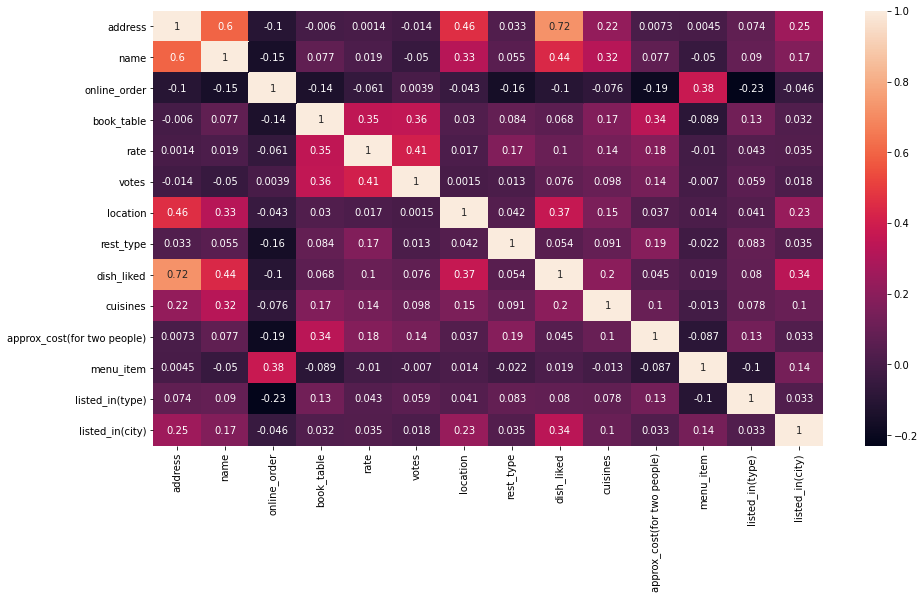

In [76]:
import matplotlib.pyplot as plt
import seaborn as sns

corr = zomen.corr(method='kendall')
plt.figure(figsize=(15,8))
sns.heatmap(corr, annot=True)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 1.0, 'how many people prefer online order')

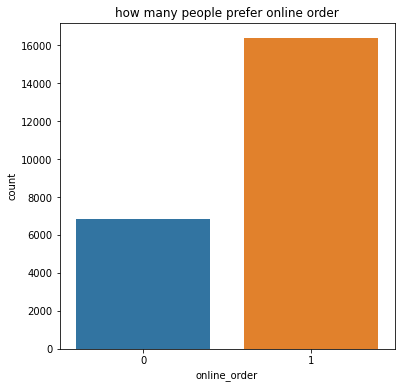

In [77]:
sns.countplot(data['online_order'])
fig = plt.gcf()
fig.set_size_inches(6,6)
plt.title('how many people prefer online order')

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 1.0, 'table book counts')

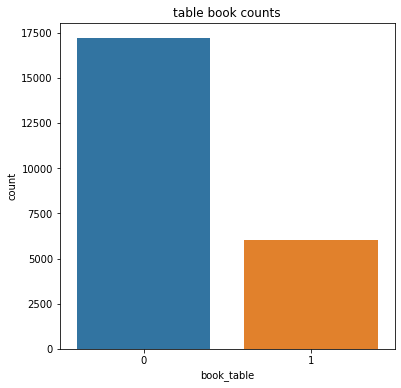

In [78]:
sns.countplot(data['book_table'])
fig = plt.gcf()
fig.set_size_inches(6,6)
plt.title('table book counts')

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 1.0, ' rating visualization')

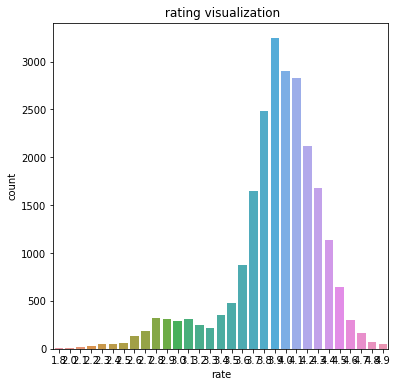

In [79]:
sns.countplot(data['rate'])
fig = plt.gcf()
fig.set_size_inches(6,6)
plt.title(' rating visualization')

Text(0.5, 1.0, 'book_tabel Vs rate')

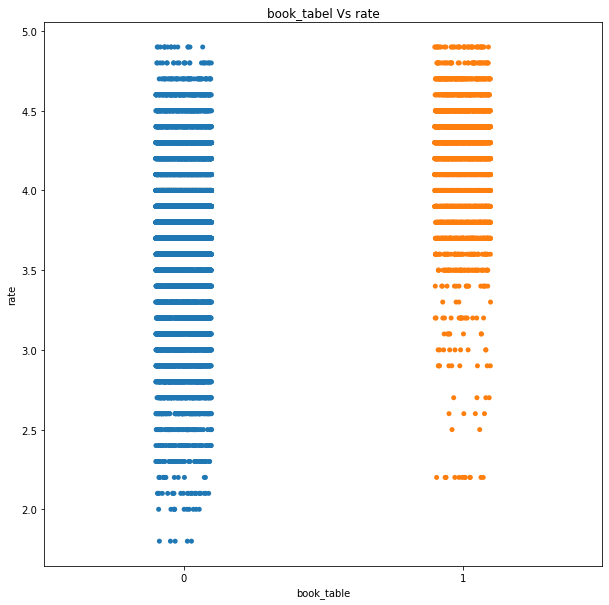

In [80]:
fig=plt.gcf()
fig.set_size_inches(10,10)
sns.stripplot(x=data["book_table"],y=data["rate"])
plt.title("book_tabel Vs rate")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


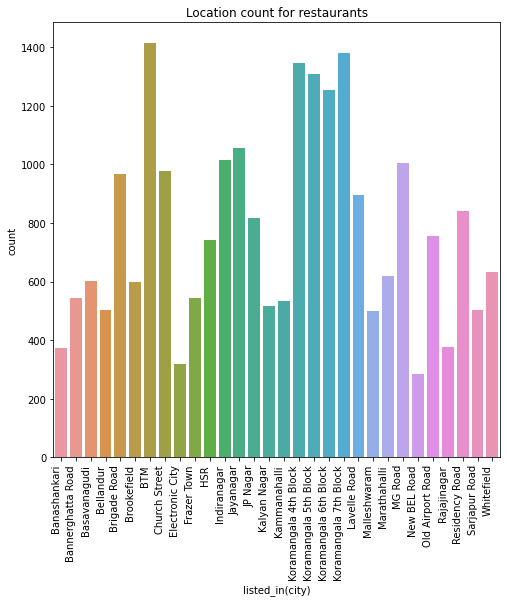

In [81]:
sns.countplot(data["listed_in(city)"]).set_xticklabels(sns.countplot(data["listed_in(city)"]).get_xticklabels(), rotation=90, ha="right")
fig = plt.gcf()
fig.set_size_inches(8,8)
plt.title('Location count for restaurants')
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 1.0, 'Restuarant Type')

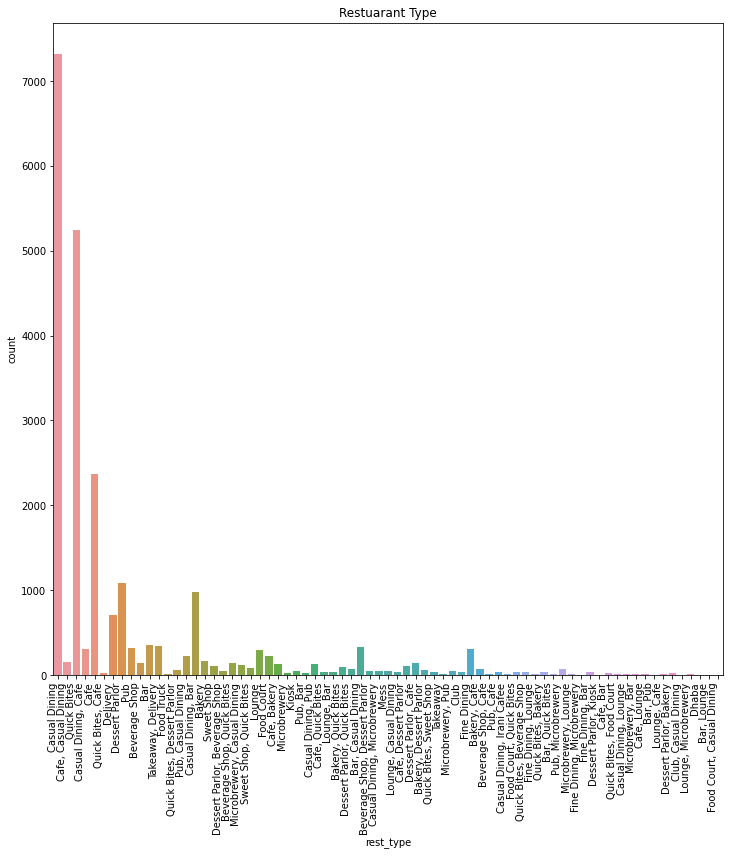

In [82]:
sns.countplot(data['rest_type'])
sns.countplot(data['rest_type']).set_xticklabels(sns.countplot(data['rest_type']).get_xticklabels(),rotation=90, ha="right")
fig = plt.gcf()
fig.set_size_inches(12,12)
plt.title('Restuarant Type')

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn

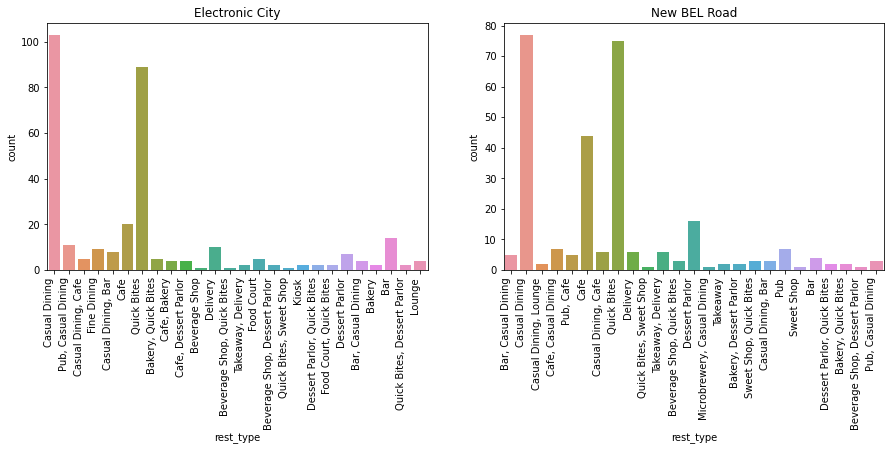

In [83]:
plt.figure(figsize=(15,10), facecolor='w')
plotnumber = 1

for column in c:
    if plotnumber<=4 :
        ax = plt.subplot(2,2,plotnumber)
        sns.countplot(column['rest_type']).set_xticklabels(sns.countplot(column['rest_type']).get_xticklabels(), rotation=90, ha="right")
        plt.title(column["listed_in(city)"].unique()[0])
    plotnumber+=1
plt.show()

In [84]:
z=data[data["listed_in(city)"]=="Electronic City"]
b=data[data["listed_in(city)"]=="New BEL Road"]
c=[z,b]

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn

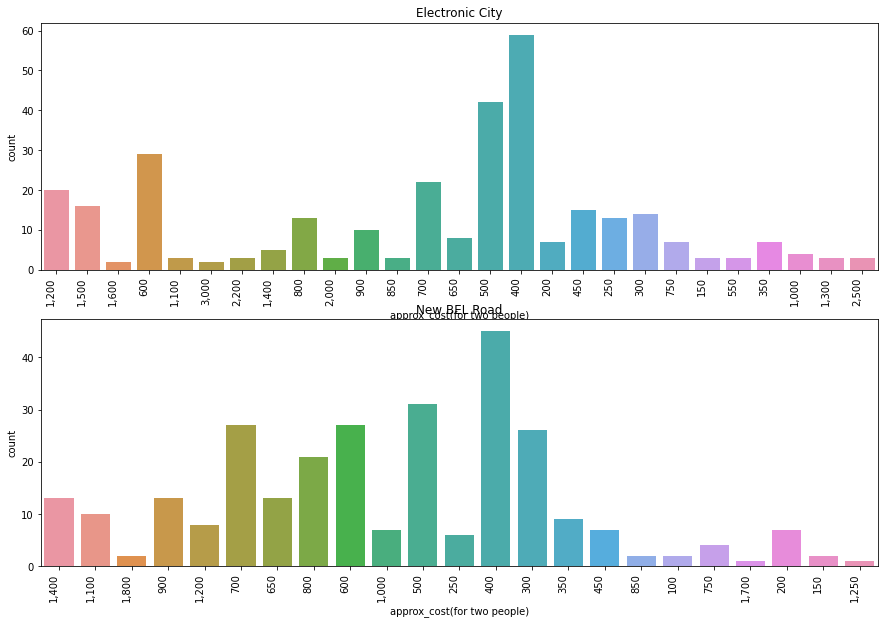

In [85]:
plt.figure(figsize=(15,10), facecolor='w')
plotnumber = 1

for column in c:
    if plotnumber<=2 :
        ax = plt.subplot(2,1,plotnumber)
        sns.countplot(column['approx_cost(for two people)']).set_xticklabels(sns.countplot(column['approx_cost(for two people)']).get_xticklabels(), rotation=90, ha="right")
        plt.title(column["listed_in(city)"].unique()[0])
    plotnumber+=1
plt.show()

Text(0.5, 0, 'Number of outlets')

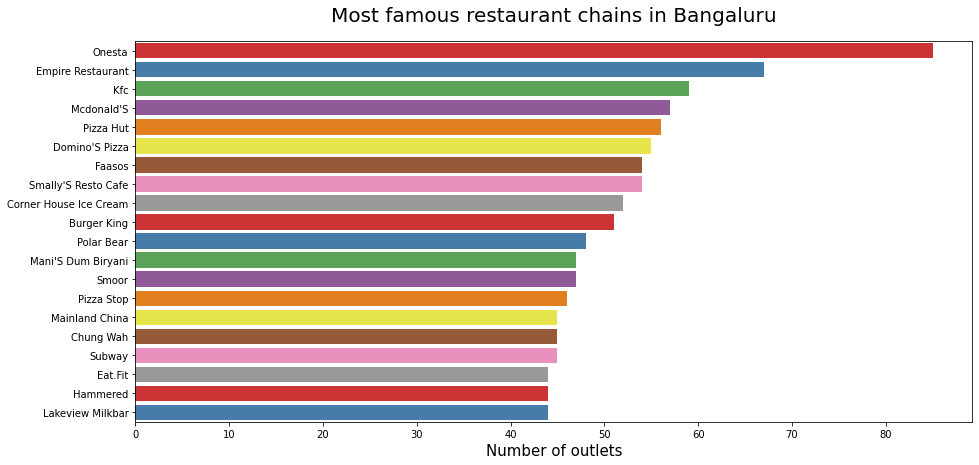

In [86]:
plt.figure(figsize=(15,7))
chains=data['name'].value_counts()[:20]
sns.barplot(x=chains,y=chains.index,palette='Set1')
plt.title("Most famous restaurant chains in Bangaluru",size=20,pad=20)
plt.xlabel("Number of outlets",size=15)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


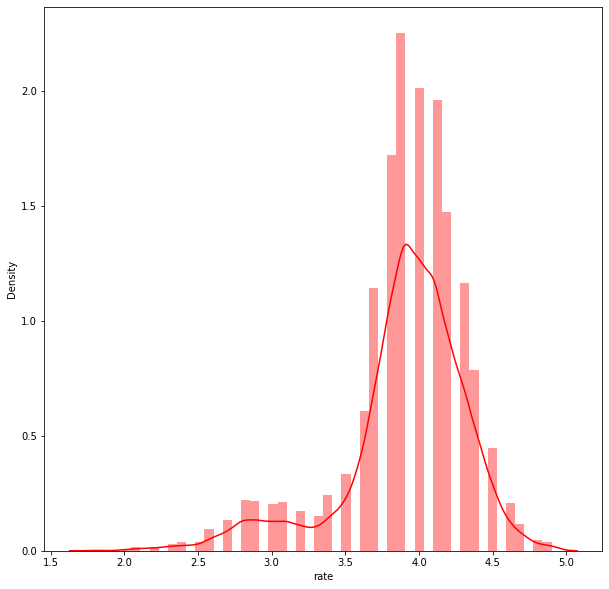

In [87]:
plt.figure(figsize = (10, 10))
sns.distplot(data['rate'], color = 'red')

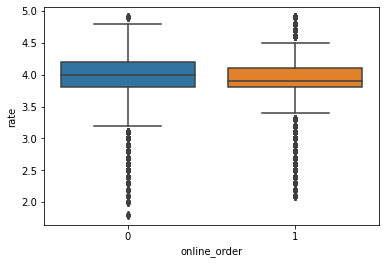

In [88]:
sns.boxplot(x = 'online_order', y = 'rate', data = data)

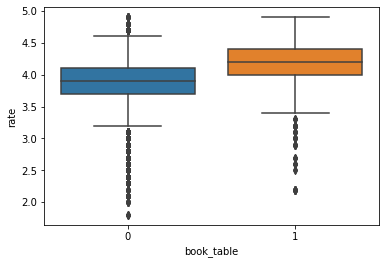

In [89]:
sns.boxplot(x = 'book_table', y = 'rate', data = data)


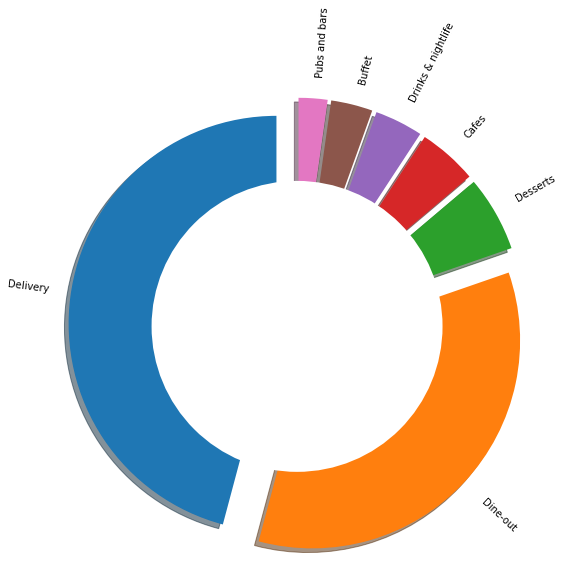

In [90]:
# Pie chart
labels = data['listed_in(type)'].value_counts().index
sizes = data['listed_in(type)'].value_counts().values
# only "explode" the 2nd slice (i.e. 'Hogs')
explode = (0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1)
fig1, ax1 = plt.subplots(figsize = (8, 8))

ax1.pie(sizes, labels = labels,shadow = True, startangle = 90, explode = explode, rotatelabels = True)
centre_circle = plt.Circle((0, 0), 0.70,fc = 'white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Equal aspect ratio ensures that pie is drawn as a circle
ax1.axis('equal')  
plt.tight_layout()
plt.show()